In [1]:
import re
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df=pd.read_csv('C:/Users/q/Desktop/James/Schulich/Data Science/listings.csv')

In [3]:
df_explore = df.copy()
##只是为了有个copy，可以进行调整

In [4]:
df_explore.shape

(21092, 79)

In [5]:
df_explore.info()
#要每一个column都过一次，看看为什么不是21092，是否合理
#比如price，不应该有缺失值，而且type不应该是object
#有缺失值可能是因为不是actively listing，但要查明以后才能确认

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21092 entries, 0 to 21091
Data columns (total 79 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            21092 non-null  int64  
 1   listing_url                                   21092 non-null  object 
 2   scrape_id                                     21092 non-null  int64  
 3   last_scraped                                  21092 non-null  object 
 4   source                                        21092 non-null  object 
 5   name                                          21092 non-null  object 
 6   description                                   20686 non-null  object 
 7   neighborhood_overview                         9588 non-null   object 
 8   picture_url                                   21092 non-null  object 
 9   host_id                                       21092 non-null 

In [6]:
pd.set_option('display.max_columns', None)
##这是什么意思？设置 pandas 显示所有的列，不隐藏任何一列。

In [7]:
df_explore.loc[15532]['amenities']
# 看一下这部分，目前是无法被使用的

'["Wine glasses", "Wifi", "Freezer", "Pets allowed", "Dining table", "Kitchen", "Hot water", "Private entrance", "Shampoo", "Exterior security cameras on property", "Shower gel", "Clothing storage", "Elevator", "Paid parking garage on premises", "Books and reading material", "Stove", "Coffee", "Dryer", "Dishes and silverware", "TV", "Washer", "Host greets you", "Dedicated workspace", "Toaster", "Iron", "Paid parking lot off premises", "Dishwasher", "Conditioner", "Cooking basics", "Smoke alarm", "Hangers", "Hair dryer", "Extra pillows and blankets", "Cleaning products", "Portable fans", "Microwave", "Air conditioning", "Coffee maker", "Trash compactor", "Hot water kettle", "Gym in building", "Essentials", "Refrigerator", "Heating", "Exercise equipment", "Bed linens", "Long term stays allowed", "Body soap", "Housekeeping - available at extra cost"]'

In [8]:
# Step 1 - drop rows that have missing price bc they are inactive
df_explore.dropna(subset=['price'], inplace=True)

In [9]:
df_explore.shape

(15365, 79)

In [10]:
# Step 2 - drop columns with no values

df_explore.drop(['calendar_updated','neighbourhood_group_cleansed'],axis=1, inplace=True)

In [11]:
df_explore.shape

(15365, 77)

In [12]:
all_amenities = ','.join(df_explore['amenities'])

In [13]:
all_amenities
#这里面会发现很多的描述有问题，我们可以大概看一下有问题的规律，比如\\u2019

'["Wine glasses", "Shared sauna", "Paid parking on premises", "Wifi", "Freezer", "Single level home", "Children\\u2019s dinnerware", "Pets allowed", "Blender", "Dining table", "Kitchen", "Hot water", "Rice maker", "Shampoo", "Private entrance", "Electric stove", "Building staff", "Clothing storage", "Shower gel", "Baking sheet", "Outdoor furniture", "Elevator", "Books and reading material", "Luggage dropoff allowed", "Bathtub", "Room-darkening shades", "Private hot tub", "Babysitter recommendations", "Dishes and silverware", "Free dryer \\u2013 In unit", "Central air conditioning", "Dedicated workspace", "Free washer \\u2013 In unit", "Shared pool - available all year", "Iron", "Dishwasher", "City skyline view", "Cooking basics", "Smoke alarm", "Self check-in", "Oven", "Hangers", "Hair dryer", "Extra pillows and blankets", "Carbon monoxide alarm", "Cleaning products", "TV with Fire TV", "Portable fans", "Fire extinguisher", "Microwave", "Patio or balcony", "Coffee maker", "Housekeeping

In [14]:
all_amenities = re.sub(r'\\u[0-9a-zA-Z]{4}', '', all_amenities)

In [15]:
all_amenities = re.sub(r'  ', ' ', all_amenities)
#打开来以后，可以再看看是不是需要修改的，比如有很多的space

In [16]:
all_amenities

'["Wine glasses", "Shared sauna", "Paid parking on premises", "Wifi", "Freezer", "Single level home", "Childrens dinnerware", "Pets allowed", "Blender", "Dining table", "Kitchen", "Hot water", "Rice maker", "Shampoo", "Private entrance", "Electric stove", "Building staff", "Clothing storage", "Shower gel", "Baking sheet", "Outdoor furniture", "Elevator", "Books and reading material", "Luggage dropoff allowed", "Bathtub", "Room-darkening shades", "Private hot tub", "Babysitter recommendations", "Dishes and silverware", "Free dryer In unit", "Central air conditioning", "Dedicated workspace", "Free washer In unit", "Shared pool - available all year", "Iron", "Dishwasher", "City skyline view", "Cooking basics", "Smoke alarm", "Self check-in", "Oven", "Hangers", "Hair dryer", "Extra pillows and blankets", "Carbon monoxide alarm", "Cleaning products", "TV with Fire TV", "Portable fans", "Fire extinguisher", "Microwave", "Patio or balcony", "Coffee maker", "Housekeeping available 4 days a wee

In [24]:
all_amenities = re.sub(r'[\{\}\[\]"\']', '', all_amenities)

In [ ]:
all_amenities = all_amenities.split(',')
#每一条跑完就要看一下哪里还需要调整

In [26]:
all_amenities = [item.lstrip() for item in all_amenities]

In [28]:
all_amenities

['Wineglasses',
 'Sharedsauna',
 'Paidparkingonpremises',
 'Wifi',
 'Freezer',
 'Singlelevelhome',
 'Childrensdinnerware',
 'Petsallowed',
 'Blender',
 'Diningtable',
 'Kitchen',
 'Hotwater',
 'Ricemaker',
 'Shampoo',
 'Privateentrance',
 'Electricstove',
 'Buildingstaff',
 'Clothingstorage',
 'Showergel',
 'Bakingsheet',
 'Outdoorfurniture',
 'Elevator',
 'Booksandreadingmaterial',
 'Luggagedropoffallowed',
 'Bathtub',
 'Room-darkeningshades',
 'Privatehottub',
 'Babysitterrecommendations',
 'Dishesandsilverware',
 'FreedryerInunit',
 'Centralairconditioning',
 'Dedicatedworkspace',
 'FreewasherInunit',
 'Sharedpool-availableallyear',
 'Iron',
 'Dishwasher',
 'Cityskylineview',
 'Cookingbasics',
 'Smokealarm',
 'Selfcheck-in',
 'Oven',
 'Hangers',
 'Hairdryer',
 'Extrapillowsandblankets',
 'Carbonmonoxidealarm',
 'Cleaningproducts',
 'TVwithFireTV',
 'Portablefans',
 'Fireextinguisher',
 'Microwave',
 'Patioorbalcony',
 'Coffeemaker',
 'Housekeepingavailable4daysaweek-availableatextra

In [29]:
from collections import Counter

amenity_counts = dict(Counter(all_amenities))

In [ ]:
sorted_amenities = dict(sorted(amenity_counts.items(), key=lambda item: item[1], reverse=True))

print(sorted_amenities)
#这样可以知道哪些设施是热门的，这对后面的分析有帮助

{'Smokealarm': 14887, 'Kitchen': 14028, 'Wifi': 13954, 'Carbonmonoxidealarm': 13517, 'Hotwater': 12800, 'Hangers': 12144, 'Dishesandsilverware': 11827, 'Hairdryer': 11552, 'Microwave': 11275, 'Essentials': 11207, 'Cookingbasics': 11144, 'Bedlinens': 11091, 'Refrigerator': 10771, 'Iron': 10390, 'Dedicatedworkspace': 10058, 'Shampoo': 9891, 'Airconditioning': 9853, 'Fireextinguisher': 9406, 'Hotwaterkettle': 9307, 'Selfcheck-in': 8608, 'Washer': 8508, 'Cleaningproducts': 8485, 'Diningtable': 8480, 'Longtermstaysallowed': 8335, 'TV': 8037, 'Freezer': 7970, 'Toaster': 7877, 'Extrapillowsandblankets': 7474, 'Dishwasher': 7451, 'Showergel': 7217, 'Heating': 7179, 'Firstaidkit': 7043, 'Wineglasses': 6994, 'Oven': 6878, 'Bodysoap': 6821, 'Bathtub': 6577, 'Stove': 6212, 'Conditioner': 6192, 'Privateentrance': 6160, 'Coffee': 5932, 'Room-darkeningshades': 5885, 'Centralheating': 5757, 'Freeparkingonpremises': 5259, 'Coffeemaker': 5066, 'Exteriorsecuritycamerasonproperty': 5015, 'FreedryerInunit'

In [ ]:
# Step 3: create dummy variables to capture whether each listing has the top 5 amenities or not
# Smoke alarm
# Kitchen
# Wifi
# Carbon monoxide alarm
# Hot water

In [35]:
#假设要预测的是price

dep = ['price']

#将所有要用的自变数分成三种，特性、连续(continous)、间断（disc）
cat_variables = ['host_location','host_response_time','host_is_superhost', 'host_neighbourhood','host_has_profile_pic','host_identity_verified','neighbourhood_cleansed','property_type','room_type','has_availability', 'license','instantly_bookable']

cont_vars = ['host_response_rate','host_acceptance_rate', 'latitude','longitude','bathrooms','bedrooms','beds','review_scores_rating', 'reviews_per_month']

disc_vars = ['host_listings_count','host_total_listings_count','accommodates','minimum_nights','maximum_nights','avalibility_30','availability_60', 'availability_90','availability_365','number_of_reviews']

In [ ]:
# Step 6 -- for price, clean to make numeric
df_explore['price'] = df_explore['price'].str.replace('$', '')
df_explore['price'] = df_explore['price'].str.replace(',', '')
df_explore['price'] = pd.to_numeric(df_explore['price'])

C:\Users\q\AppData\Local\Temp\ipykernel_7528\10675894.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_explore['price'])


<Axes: xlabel='price', ylabel='Density'>

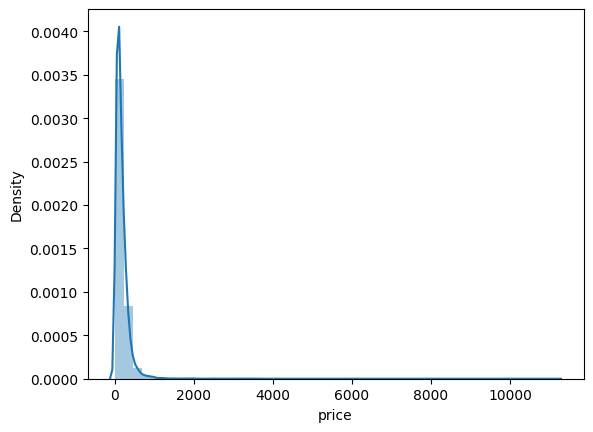

In [33]:
sns.distplot(df_explore['price'])

C:\Users\q\AppData\Local\Temp\ipykernel_7528\3082499189.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log(df_explore['price']))


<Axes: xlabel='price', ylabel='Density'>

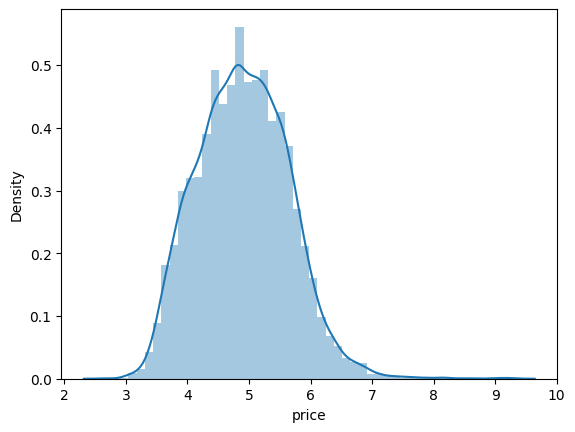

In [ ]:
sns.distplot(np.log(df_explore['price']))
#将价格对数化了

In [ ]:
df_explore[cont_vars]
#再看看有没有需要清理的数据？

,host_response_rate,host_acceptance_rate,latitude,longitude,bathrooms,bedrooms,beds,review_scores_rating,reviews_per_month
2,90%,29%,43.64608,-79.390320,1.0,2.0,2.0,4.80,0.26
6,100%,NaN,43.74922,-79.291880,0.0,2.0,4.0,4.96,0.65
7,100%,40%,43.67193,-79.385900,1.0,1.0,1.0,4.18,0.37
8,100%,40%,43.66123,-79.383360,1.0,0.0,1.0,4.17,0.50
9,100%,40%,43.67180,-79.384880,1.0,1.0,1.0,4.40,0.13
...,...,...,...,...,...,...,...,...,...
21087,88%,25%,43.67123,-79.389380,1.0,1.0,2.0,NaN,NaN
21088,NaN,100%,43.65827,-79.373340,0.0,2.0,3.0,NaN,NaN
21089,100%,100%,43.64845,-79.393582,1.0,2.0,3.0,NaN,NaN
21090,100%,100%,43.75749,-79.442840,3.0,4.0,6.0,NaN,NaN


In [37]:
# Step 7 - clean up continuous data

def clean_continuous_columns(df, cont_vars):

    for col in cont_vars:

        # Check if column is object or string and has any values with '%'

        if df[col].dtype == 'object' and df[col].astype(str).str.contains('%').any():

            df[col] = df[col].str.rstrip('%').astype(float) / 100  # Convert to proportion

    return df

In [ ]:
df_explore = clean_continuous_columns(df_explore, cont_vars)
#先确定continuous变数的格式没问题，再存到df_explore

In [39]:
df_explore[cont_vars].info()

<class 'pandas.core.frame.DataFrame'>
Index: 15365 entries, 2 to 21091
Data columns (total 9 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   host_response_rate    12964 non-null  float64
 1   host_acceptance_rate  13269 non-null  float64
 2   latitude              15365 non-null  float64
 3   longitude             15365 non-null  float64
 4   bathrooms             15357 non-null  float64
 5   bedrooms              15344 non-null  float64
 6   beds                  15352 non-null  float64
 7   review_scores_rating  12037 non-null  float64
 8   reviews_per_month     12037 non-null  float64
dtypes: float64(9)
memory usage: 1.2 MB


In [ ]:
#接着确认其他2类变数也没有问题
#可以用header或是随机取样一下，看看数据格式，看看是否可以让我们直接使用还是需要调整
disc_vars = ['host_listings_count','host_total_listings_count','accommodates','minimum_nights','maximum_nights','availability_30','availability_60', 'availability_90','availability_365','number_of_reviews']

In [41]:
cat_variables = ['host_location','host_response_time','host_is_superhost', 'host_neighbourhood','host_has_profile_pic','host_identity_verified','neighbourhood_cleansed','property_type','room_type','has_availability','instant_bookable']

In [43]:
import matplotlib.pyplot as plt

import seaborn as sns

 

def plot_scatter_relationships(df, features, target='price'):

    for feature in features:

        plt.figure(figsize=(6, 4))

        sns.scatterplot(data=df, x=feature, y=target, alpha=0.5)

        plt.title(f'{feature} vs. {target}')

        plt.xlabel(feature)

        plt.ylabel(target)

        plt.grid(True)

        plt.tight_layout()

        plt.show()

In [44]:
def plot_boxplots(df, categorical_features, target='price'):

    for feature in categorical_features:

        plt.figure(figsize=(8, 4))

        sns.boxplot(data=df, x=feature, y=target)

        plt.title(f'{feature} vs. {target}')

        plt.xlabel(feature)

        plt.ylabel(target)

        plt.xticks(rotation=45)

        plt.tight_layout()

        plt.show()

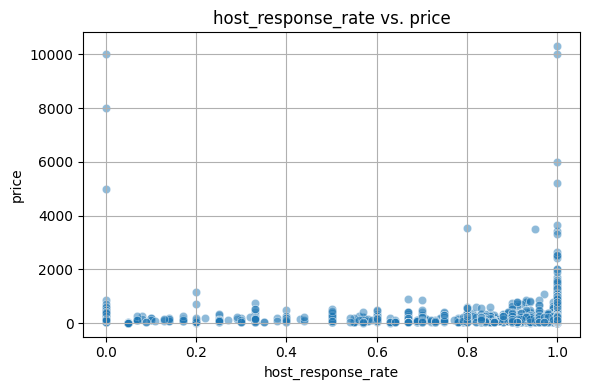

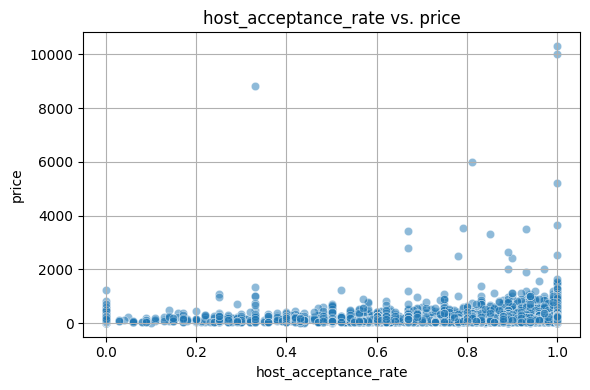

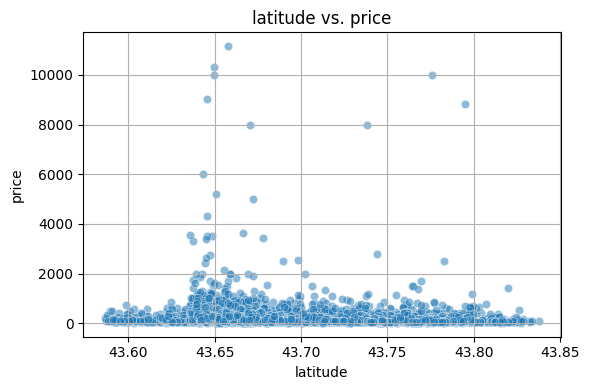

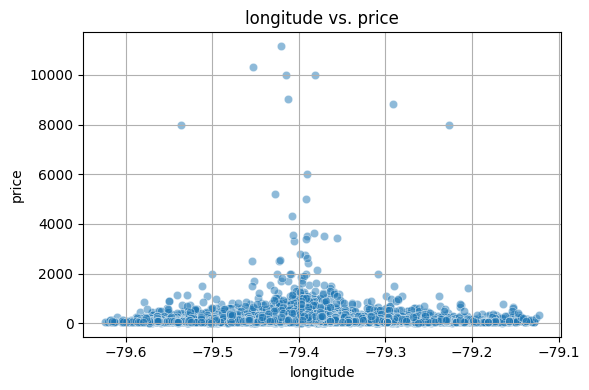

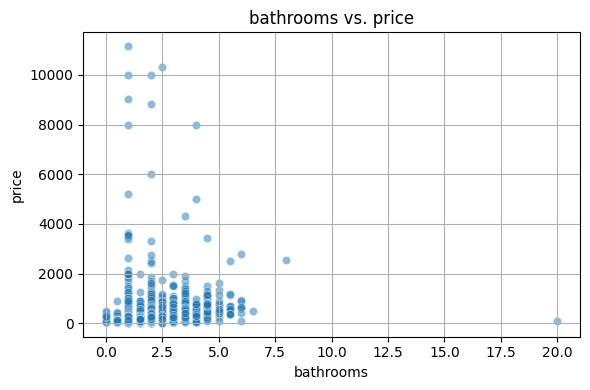

...

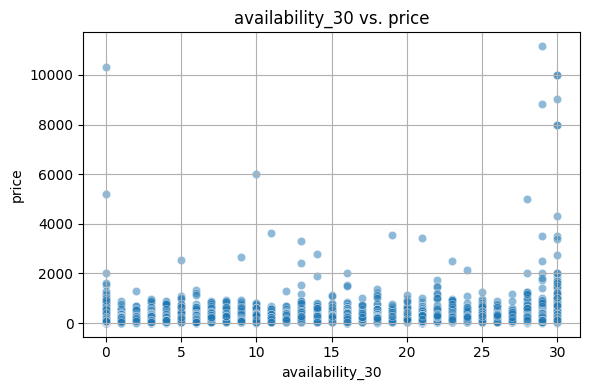

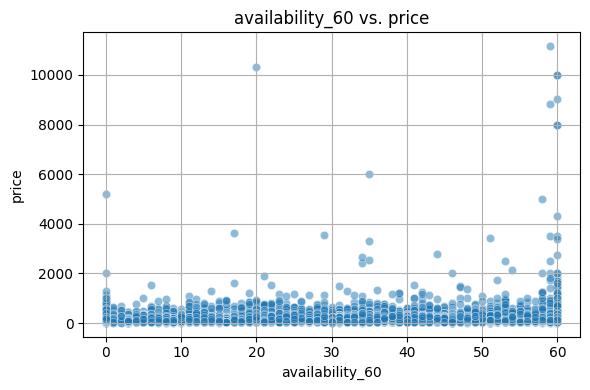

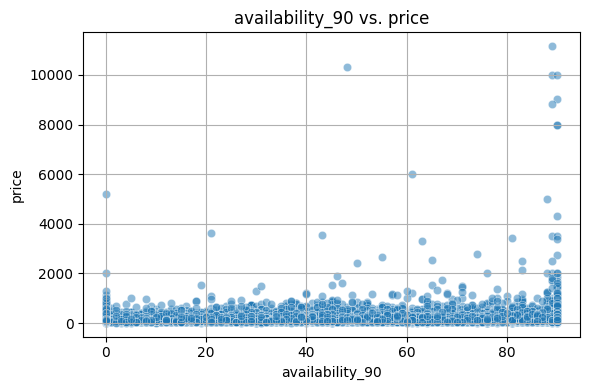

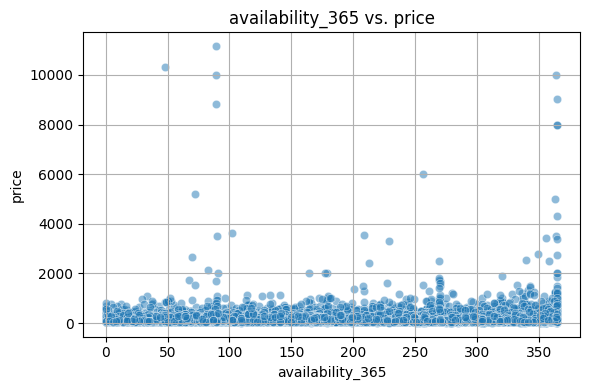

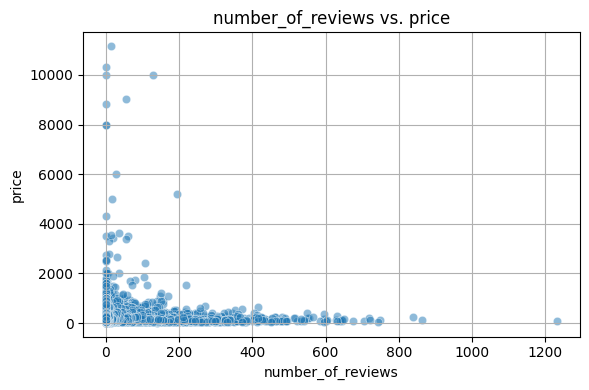

In [ ]:
plot_scatter_relationships(df_explore, cont_vars + disc_vars, target='price')
#可以看看所有变数和价格之间的关系

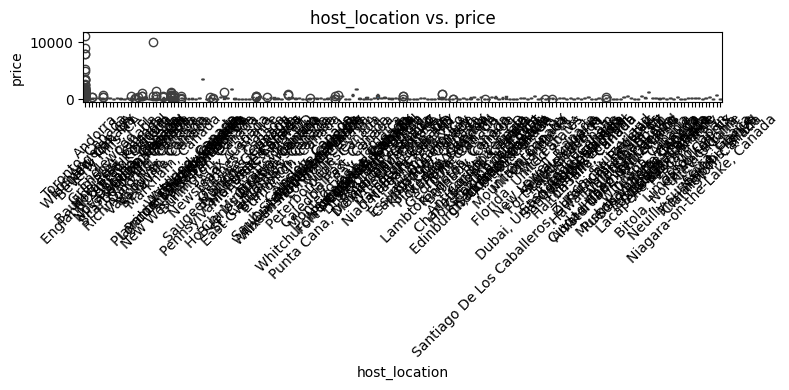

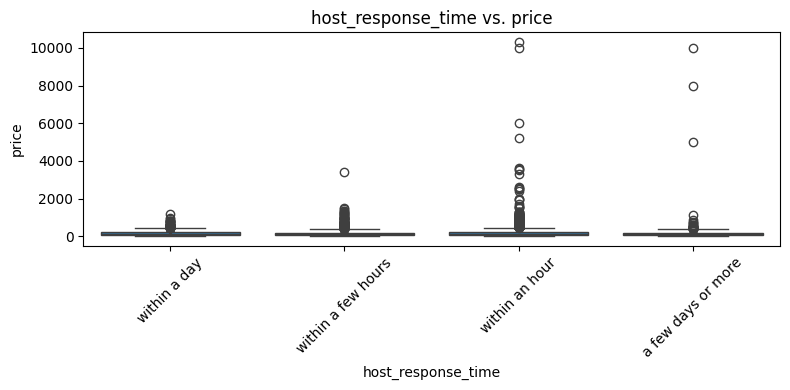

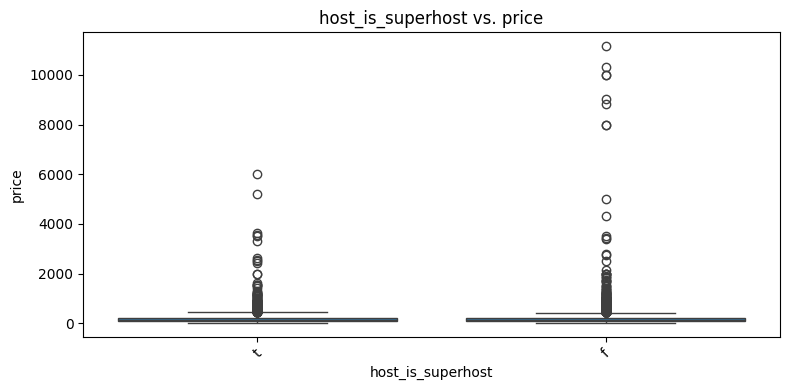

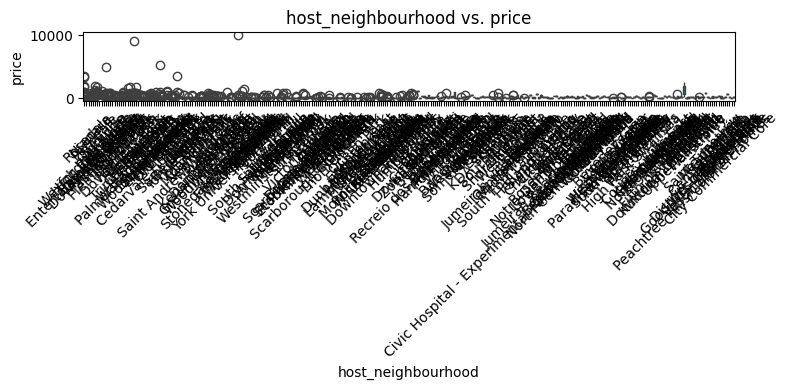

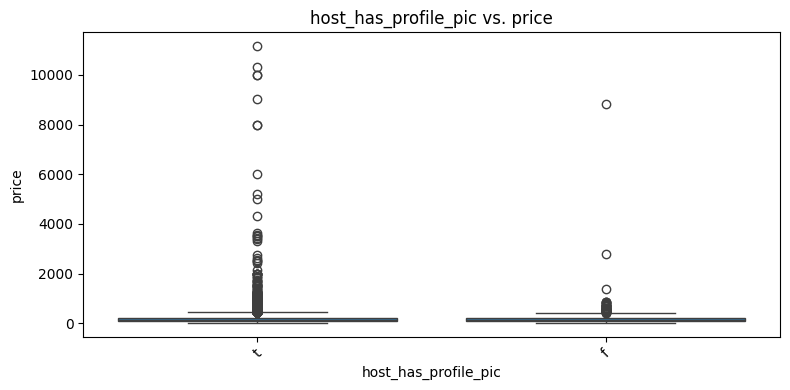

...

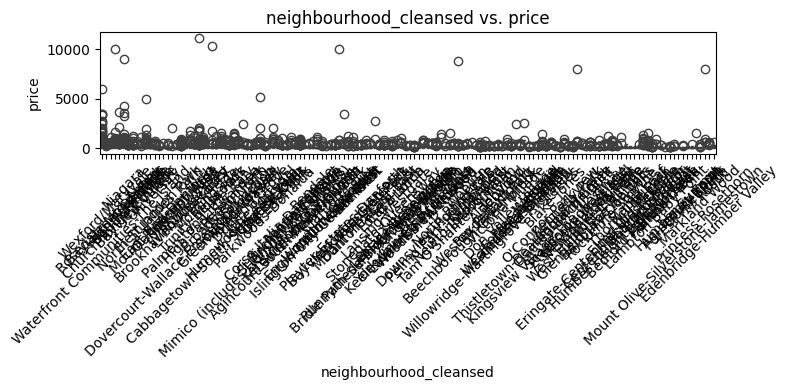

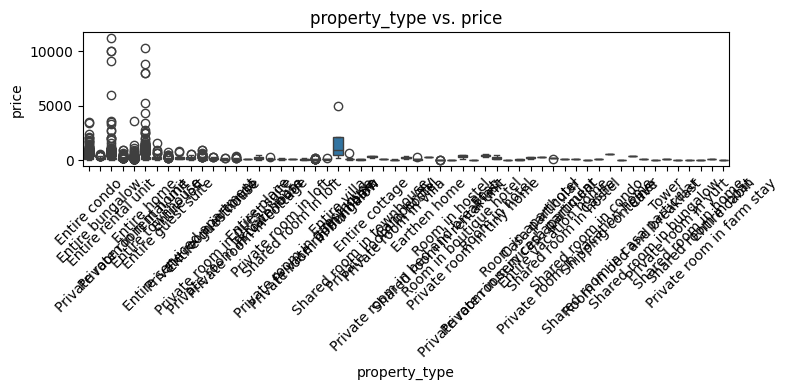

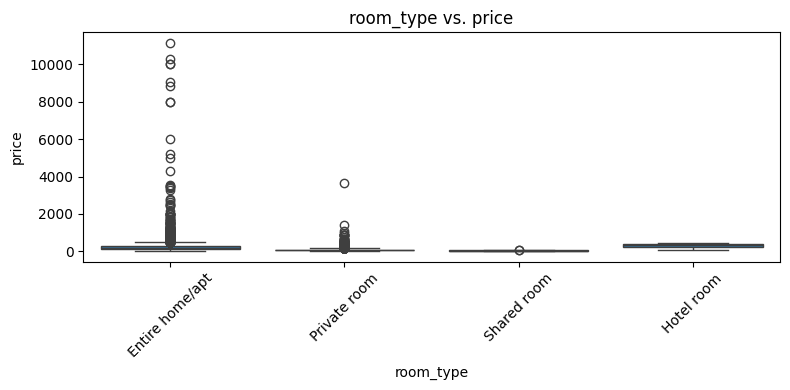

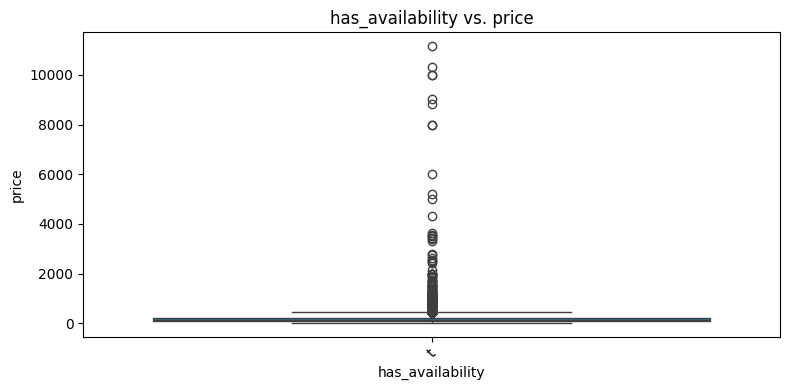

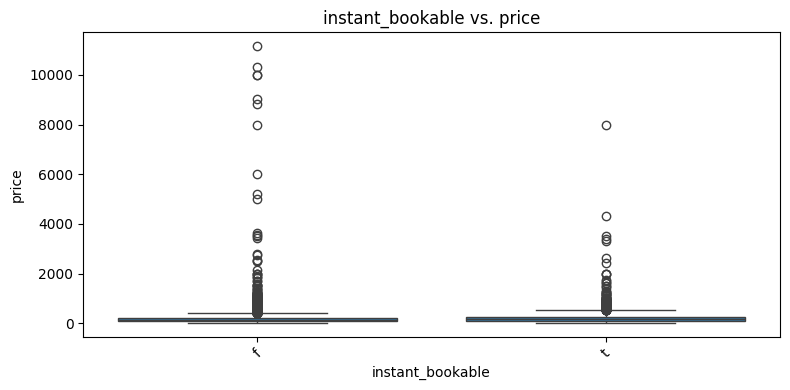

In [46]:
plot_boxplots(df_explore, cat_variables, target='price')

In [ ]:
#透过上面的所有可视化，可以进一步确认在预测的时候要包含哪些变数

In [47]:
#重新调整后的所有变数如下
dep = ['price']
cat_variables = ['host_location','host_response_time','host_is_superhost', 'host_neighbourhood','host_has_profile_pic','host_identity_verified','neighbourhood_cleansed','property_type','room_type','instant_bookable']
cont_vars = ['host_response_rate','host_acceptance_rate', 'latitude','longitude','bathrooms','bedrooms','beds','review_scores_rating', 'reviews_per_month']
disc_vars = ['host_listings_count','host_total_listings_count','accommodates','minimum_nights','maximum_nights','availability_30','availability_60', 'availability_90','availability_365','number_of_reviews']

In [ ]:
#outlier不一定要拿掉，如果要拿掉的话可以根据实际情况，和要解决的问题去调整
#比如拿掉99%百分位以外的数据

In [49]:
# 现在要将top 5 amentity拿回来，放进variable中
# 用dummy variable代表这几个变量
# Step 8 - transform the dataset to look for top amenities
def add_amenity_indicators(df, amenity_col, top_amenities):

    for amenity in top_amenities:

        col_name = f'has_{amenity.lower().replace(" ", "_")}'

        df[col_name] = df[amenity_col].str.contains(amenity, case=False, na=False).astype(int)

    return df

In [50]:

top_amenities = [
    'Smoke alarm',
    'Kitchen',
    'Wifi',
    'Carbon monoxide alarm',
    'Hot water'
]

df_explore = add_amenity_indicators(df_explore, 'amenities', top_amenities)

In [ ]:
#现在top 5 amentity被放进了 cat_variables
dep = ['price']

cat_variables = ['host_location','host_response_time','host_is_superhost', 'host_neighbourhood','host_has_profile_pic','host_identity_verified','neighbourhood_cleansed','property_type','room_type','instant_bookable','has_smoke_alarm', 'has_kitchen', 'has_wifi', 'has_carbon_monoxide_alarm', 'has_hot_water']
cont_vars = ['host_response_rate','host_acceptance_rate', 'latitude','longitude','bathrooms','bedrooms','beds','review_scores_rating', 'reviews_per_month']
disc_vars = ['host_listings_count','host_total_listings_count','accommodates','minimum_nights','maximum_nights','availability_30','availability_60', 'availability_90','availability_365','number_of_reviews']

In [54]:
y = df_explore[dep]
X = df_explore[cat_variables + cont_vars + disc_vars]

In [52]:
from sklearn.model_selection import train_test_split

In [ ]:
#这里将数据分组
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# 注意，前面都没有考虑missing value，因为我们要先确认数据格式被调整好，才不会影响插入值在dataset中的效果
# 比如Amentity，如果很多空值或是乱码，而我基于频繁出现的数据，填补missing value，那我所插入的值就不一定合理，而且可能出现乱码
# 而且只要针对要做训练的值，插入值即可
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer

In [ ]:
#这几行代码是用来填补（补齐）数据中缺失值（NaN）的工具
#catimp = SimpleImputer(strategy='most_frequent')
#作用：用“出现最频繁的值”来填补缺失值
#常用于：类别型（分类型）数据，比如性别、城市名称等
#例子：如果某一列大多数是“Male”，有缺失值时就用“Male”补上。

#numimp = SimpleImputer(strategy='constant', fill_value=0)
#作用：用“固定值0”来填补缺失值
#常用于：数值型数据
#例子：如果某一列收入有缺失，就用0来补。

#discimp = SimpleImputer(strategy='median')
#作用：用“中位数”来填补缺失值
#常用于：数值型数据，尤其是有异常值（outlier）的时候
#例子：如果某一列房价有缺失，用现有数据的中位数补上。

catimp = SimpleImputer(strategy='most_frequent')
numimp = SimpleImputer(strategy='constant', fill_value=0)
discimp = SimpleImputer(strategy='median')

In [ ]:
# 现在要填入X_train
X_train[cat_variables] = catimp.fit_transform(X_train[cat_variables])
X_train[cont_vars] = numimp.fit_transform(X_train[cont_vars])
X_train[disc_vars] = discimp.fit_transform(X_train[disc_vars])

In [ ]:
#要看看X_train和X_test的区别，然后看看为什么要分组

In [ ]:
#这里在干嘛？
encoder = OneHotEncoder(sparse_output=False, drop='first')
X_encoded = encoder.fit_transform(X_train[cat_variables])

In [80]:
# Transforming the TEST data
X_test[cat_variables] = catimp.transform(X_test[cat_variables])
X_test[cont_vars] = numimp.transform(X_test[cont_vars])
X_test[disc_vars] = discimp.transform(X_test[disc_vars])

In [86]:
#这里在干嘛？
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train[cont_vars + disc_vars])

In [96]:
#这里在干嘛？
X_final = np.concatenate((X_encoded, X_scaled), axis=1)

ValueError: all the input array dimensions except for the concatenation axis must match exactly, but along dimension 0, the array at index 0 has size 12292 and the array at index 1 has size 12331

In [89]:
#这里在干嘛？
X_train = X_final.copy()

In [90]:
# Check the encoder issues:

df_explore[df_explore['property_type'].isin(['Castle', 'Entire cabin', 'Private room in cottage'])].index

Index([195, 10427, 20704], dtype='int64')

In [91]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [92]:
X_train = pd.concat([X_train, X.loc[[269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,

        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,

       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704]]], axis=0)

In [93]:
y_train = pd.concat([y_train, y.loc[[269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,

        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,

       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704]]], axis=0)

In [94]:
X_test.drop([269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,

        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,

       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704], inplace=True)

y_test.drop([269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,

        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,

       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704], inplace=True)

In [95]:
X_test_encoded = encoder.transform(X_test[cat_variables])

ValueError: Found unknown categories [nan] in column 0 during transform

In [74]:
X_test_scaled = scaler.transform(X_test[cont_vars + disc_vars])

In [75]:
X_test_final = np.concatenate((X_test_encoded, X_test_scaled), axis=1)

NameError: name 'X_test_encoded' is not defined

In [76]:
from sklearn.linear_model import LinearRegression

from sklearn.model_selection import cross_val_score

from sklearn.metrics import mean_squared_error, r2_score

In [77]:
lr = LinearRegression()

In [78]:
scores = cross_val_score(lr, X_train, y_train, cv=5, scoring='neg_mean_squared_error')

ValueError: 
All the 5 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\linear_model\_base.py", line 678, in fit
    X, y = self._validate_data(
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py", line 622, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\validation.py", line 1146, in check_X_y
    X = check_array(
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\validation.py", line 915, in check_array
    array = _asarray_with_order(array, order=order, dtype=dtype, xp=xp)
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\utils\_array_api.py", line 380, in _asarray_with_order
    array = numpy.asarray(array, order=order, dtype=dtype)
  File "c:\Users\q\AppData\Local\Programs\Python\Python38\lib\site-packages\pandas\core\generic.py", line 1998, in __array__
    arr = np.asarray(values, dtype=dtype)
ValueError: could not convert string to float: 'Toronto, Canada'


In [79]:
#avg square root error for the linear regression model

np.mean(np.sqrt(np.abs(scores)))

NameError: name 'scores' is not defined

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

knn = KNeighborsRegressor()

scores_knn = cross_val_score(knn, X_train, y_train, cv=5, scoring='neg_mean_squared_error')

np.mean(np.sqrt(np.abs(scores_knn)))